# DD2412: DDPM Exercise
**Authors**: Klas Wijk and Sai bharath chandra Gutha

### **Introduction:**
In this practical, we learn about a new kind of Generative models called Diffusion models. Specifically, we implement Denoising Diffusion Probabilistic Model (DDPM) [[1]](https://proceedings.neurips.cc/paper/2020/hash/4c5bcfec8584af0d967f1ab10179ca4b-Abstract.html). In VAEs, we have seen that the encoder transforms the input data distribution to an assumed prior distribution in a latent space, while the decoder transforms this latent prior distribution back into the original data distribution. Intuitvely, one could think of DDPM as a hierarchical/stacked VAE [[2]](https://nips.cc/virtual/2020/public/poster_e3b21256183cf7c2c7a66be163579d37.html), where the encoder transforms the initial data distribution $ x_0 \sim p(x_0) $ to $ x_1\sim p(x_1) $ which in turn is transformed to $ x_2\sim p(x_2) $ and until $ x_T \sim p(x_T) = \mathcal{N}(0,\mathbf{I}) $. The decoder learns the reverse transformations from $ x_T \sim p(x_T) = \mathcal{N}(0,\mathbf{I}) $ to $ x_{T-1}\sim p(x_{T-1}) $ until $ x_0 \sim p(x_0) $ which is the original data distribution. However, unlike a VAE, DDPM only learns the reverse proces (or the decoder), while using simple and fixed analytical transformations for the forward process (or the encoder). Also unlike VAE, DDPM do not learn a low-dimensional latent space as the intermediate $ x_1, x_2, .. x_T $ have the same dimensions as the original data $ x_0 $. (Later, works such as Latent Diffusion Models [[3]](https://arxiv.org/abs/2112.10752) extended diffusion models to latent space)

### **Formalize:**
Next, we formalize the above notion. DDPM involves a forward Markov process $ x_0 \to x_1 \to x_2\ ..\to x_T $, with the state transistion probabilities given by $ q(x_t|x_{t-1}) = \mathcal{N}(\sqrt{(1-\beta_t)}x_{t-1},\beta_t \mathbf{I}) $, for a choice of monotonically increasing variance schedule $ \beta_1,\beta_2,..\beta_T $ with $ 0 < \beta_t < 1\ \forall\ t\in\ \{1,..T\} $. This choice of transition kernels and the variance schedule gives that $ q(x_t|x_0) = \mathcal{N}(\sqrt{\bar{\alpha}_t}x_0, \sqrt{1-\bar{\alpha_t}}\mathbf{I}) $, where $ \bar{\alpha_t} = \prod_{i=1}^{t}(1-\beta_i) $. As $ t $ increases, $ \bar{\alpha}_t \to 0 $, and so for a large T, we have $ q(x_T|x_0) = \mathcal{N}(\sqrt{\bar{\alpha}_T}x_0,\sqrt{1-\bar{\alpha_T}}\mathbf{I}) \approx \mathcal{N}(0,\mathbf{I}) $, which also imply $ q(x_T)=\mathcal{N}(0,\mathbf{I}) $. This is how the forward process is designed with simple and fixed analytical transformations that also ensure we have a tractable prior distribution $ P(x_T) $.
\
\
Next, we see how the reverse process is learned in DDPM. We want to learn the transition probabilities of the reverse Markov process from $ x_T \to x_{T-1} \to .. \to x_1 \to x_0 $. Specifically $q(x_{t-1}|x_t)$. Note that the forward transistion kernel (as discussed above) is $q(x_t|x_{t-1}) = \mathcal{N}(\sqrt{(1-\beta_t)}x_{t-1},\beta_t \mathbf{I}) $. Can't we use bayes rule to figure out $q(x_{t-1}|x_t)$ ?
\
\
**TODO:** Explain the challenge there.

### **Modeling the reverse process:**
For the above reason, we try to **approximate** $q(x_{t-1}|x_t)$ with a parameterized distribution $p_{\theta}(x_{t-1}|x_t)$. Note that $ q(x_t|x_{t-1}) $ is Gaussian with variance $ \beta_t $. When $ \beta_t $ is small, it turns out that $ q(x_{t-1}|x_t) $ also has a functional form similar to a Gaussian. Note that we can make $ \beta $'s arbitrarily small if we choose long enough $ T $ such that $ q(x_T) $ can again turn out to be the standard normal distribution. For this reason, we can assume $ p_{\theta}(x_{t-1}|x_t) = \mathcal{N}(\mu_{\theta}(x_t), \Sigma_{\theta}(x_t)) $.  Now, let's put everything together!
\
\
We have the forward Markov process $ x_0 \to x_1 \to x_2 .. \to x_T $, with the transition probabilities $ q(x_t|x_{t-1}) = \mathcal{N}(\sqrt{(1-\beta_t)}x_{t-1},\beta_t \mathbf{I}) $. The reverse Markov process $ x_T \to x_{T-1} .. \to x_0 $, with true transition probabilities $ q(x_{t-1}|x_t) $ is approximated with the transition probabilities $ p_{\theta}(x_{t-1}|x_t) = \mathcal{N}(\mu_{\theta}(x_t), \Sigma_{\theta}(x_t)) $.

### **Training Objective:**
Note that, our end goal here (like every other generative model) is to model the original data distribution $ q(x_0) $. Our approximated reverse Markov chain, results in an approximated data distribution $$ p_{\theta}(x_0) = \int_{x_1,..x_T} p_{\theta}(x_0,x_1,..x_T) dx_1..dx_T $$ $$ p_{\theta}(x_0) = \int_{x_1,..x_T} p_{\theta}(x_0|x_1) p_{\theta}(x_1|x_2)..p_{\theta}(x_{T-1}|x_T) dx_1..dx_T $$ $$ p_{\theta}(x_0) = \int_{x_1,..x_T} \prod_{i=1}^T p_{\theta}(x_{i-1}|x_i) dx_1..dx_T $$ (In the above expressions, we make use of the chain rule of probability and the fact that the reverse process is Markov). Finally, to learn a good approximation (i.e. $ p_{\theta}(x_0) $) of $ q(x_0) $, we minimize the KL-divergence between those distributions to find the optimal parameters $ \theta^{*} $. $$ D_{KL}(q(x_0) || p_{\theta}(x_0)) = \int_{x_0} q(x_0) \log \frac{q(x_0)}{p_{\theta}(x_0)} $$ Minimizing this expression with respect to $ \theta $ is equivalent to minimizing the cross entropy i.e. $$ CE = \int_{x_0} - q(x_0) \log p_{\theta}(x_0) = \mathbb{E}_{x_0 \sim q}[- \log p_{\theta}(x_0)] $$In practice, we minimize an upper bound on negative log-likelihood (i.e. $-\log p_{\theta}(x_0)$) as follows (Eq.3 in [[1]](https://proceedings.neurips.cc/paper/2020/hash/4c5bcfec8584af0d967f1ab10179ca4b-Abstract.html)):
$$ CE = \mathbb{E}_{x_0 \sim q} [-\log p_{\theta}(x_0)] \leq \mathbb{E}_{x_{0:T}\sim q} \left[ -\log \frac{p_{\theta}(x_{0:T})}{q(x_{1:T}|x_0)} \right] = UB $$
Note:  $ x_{0:T} $ indicates $ (x_0,x_1,..x_T) $ and $ x_{0:T}\sim q $ implies $ (x_0,x_1,..x_T) $ is a sample from the joint distribution $ q(x_0,x_1,..x_T) $.
\
\
**TODO:** Derive $ CE \leq UB $ (Hint: Start by expanding $ D_{KL}(q(x_{1:T}|x_0)) || p_{\theta}(x_{1:T}|x_0) $ and use the upper bound on $-\log p_{\theta}(x_0)$ within the CE term).

#### **TODO:**

### **Simplifying the Upper Bound:**
The upper bound can be further expressed as $$ UB = \mathbb{E}_{x_{0:T}\sim q} \left[ -\log \frac{p_{\theta}(x_{0:T})}{q(x_{1:T}|x_0)} \right] = \mathbb{E}_{x_{0:T}\sim q} \left[ \underbrace{D_{KL}(q(x_T|x_0)||p_{\theta}(x_T))}_{L_T} + \Sigma_{t>1} \underbrace{D_{KL}(q(x_{t-1}|x_t,x_0)||p_{\theta}(x_{t-1}|x_t))}_{L_{t-1}} \underbrace{- \log p_{\theta}(x_0|x_1)}_{L_0} \right] $$
(Refer to Eq.5 and Appendix A in [[1]](https://proceedings.neurips.cc/paper/2020/hash/4c5bcfec8584af0d967f1ab10179ca4b-Abstract.html) for this reformulation)
\
\
$$=============================================================================$$
\
The term $ L_T $ can be ignored since $ q(x_T|x_0) = p_{\theta}(x_T) = \mathcal{N}(0,\mathbf{I}) $. For the term $ L_{t-1} $, note that $ p_{\theta}(x_{t-1}|x_t) = \mathcal{N}(\mu_{\theta}(x_t),\Sigma_{\theta}(x_t)) $ as discussed previously, and $ q(x_{t-1}|x_t,x_0) = \frac{q(x_t|x_{t-1})q(x_{t-1}|x_0)}{q(x_t|x_0)} $ which has an analytical formulation since $ q(x_t|x_{t-1}) $, $ q(x_{t-1}|x_0) $, and $ q(x_t|x_0) $ are all Gaussian distributed. In fact, $ q(x_{t-1}|x_t, x_0) = \mathcal{N}(\tilde{\mu}(x_t,x_0), \tilde{\beta}_t \mathbf{I}) $, where $$ \tilde{\mu}(x_t,x_0) = \frac{\sqrt{\bar{\alpha}_{t-1}}\beta_t}{1-\bar{\alpha}_t}x_0 + \frac{\sqrt{1-\beta_t}(1-\bar{\alpha}_{t-1})}{1-\bar{\alpha}_t} x_t $$ and $ \tilde{\beta}_t = \frac{1-\bar{\alpha}_{t-1}}{1-\bar{\alpha}_t} \beta_t $. Thus, both $q(x_{t-1}|x_t,x_0)$ and $p_{\theta}(x_{t-1}|x_t)$ are Gaussian distributions.
\
\
$$=============================================================================$$
\
For $p_{\theta}(x_{t-1}|x_t)$, we further assume an isotropic variance i.e. $\Sigma_{\theta}(x_t) = \sigma^2_t\mathbf{I}$. Typical choices include setting $\sigma^2_t$ to the variance of $q(x_{t-1}|x_t,x_0)$ i.e. $\sigma^2_t = \tilde{\beta}_t$ or setting it to the variance of the forward transition $q(x_t|x_{t-1})$ i.e. $\sigma^2_t = \beta_t$. Then the term $L_{t-1} $ simplifies to  $\frac{1}{2\sigma^2_t} \lVert \tilde{\mu}_{t}(x_t,x_0) - \mu_{\theta}(x_t) \rVert^2  + C $ (this is just the KL divergence of isotropic Gaussian distributions), where $C$ is a constant independent of $\theta$.
\
\
$$=============================================================================$$
\
The term $L_0 = \frac{1}{2\sigma^2_1}\lVert x_0 - \mu_{\theta}(x_1)\rVert^2 $, (we can extend the definition to set $\bar{\alpha_0}=1$) which results in $L_0 = \frac{1}{2\sigma^2_1}\lVert \tilde{\mu}_{t}(x_1,x_0) - \mu_{\theta}(x_1)\rVert^2$,  which is in a similar form as the term $L_{t-1}$, so we don't need to treat this separately in our final loss. Instead of fixed variances $\sigma^2_t$, they can also be learned in practice, which results in a slightly different expression for $L_{t-1}$. In this practical, we keep $\sigma^2_t$ fixed, and not learnable.
\
\
$$=============================================================================$$
\
From the above formulation of the upper bound, the final loss simplies into $$ L = \mathbb{E}_{x_{0:T}\sim q} \left[ \Sigma_{t\geq 1} L_{t-1} \right]$$
Note that we have $t \geq 1$ indicating that the above loss includes the term $L_0 $ and all $L_{t-1}$ terms until $L_{T-1}$, we ignore the term $L_T$ as discussed previously. Expanding the above loss: $$ L = \mathbb{E}_{x_{0:T} \sim q} \left[ \Sigma_{t \geq 1}  \frac{1}{2\sigma^2_t} \lVert \tilde{\mu}_t(x_t,x_0) - \mu_{\theta}(x_t) \rVert^2 \right] = \Sigma_{t \geq 1} \left\{ \mathbb{E}_{(x_0,x_t) \sim q} \left[  \frac{1}{2\sigma^2_t} \lVert \tilde{\mu}_t(x_t,x_0) - \mu_{\theta}(x_t) \rVert^2 \right] \right\} \text{(by linearity of Expectation)}$$

### **Parameterizing the Neural network:**
Now, let's focus on each inner term and further simplify. Notice the expectation over $(x_0,x_t)\sim q(x_0,x_t)$ in the above expression for the inner terms. As $q(x_t|x_0) = \mathcal{N}(\sqrt{\bar{\alpha}_t}x_0, \sqrt{1-\bar{\alpha}_t}\mathbf{I})$, consider the reparameterization of the random variable $x_t$ as follows $x_t = \sqrt{\bar{\alpha}_t}x_0 + \sqrt{1-\bar{\alpha}_t} \epsilon $, where $\epsilon \sim \mathcal{N}(0,\mathbf{I})$. Replacing $x_0 = \frac{x_t - \sqrt{1-\bar{\alpha}_t}\epsilon}{\sqrt{\bar{\alpha}_t}}$, we can rewrite the $\tilde{\mu}_t(x_t,x_0)$ in the inner term as: $$  \tilde{\mu}(x_t,x_0) = \frac{\sqrt{\bar{\alpha}_{t-1}}\beta_t}{1-\bar{\alpha}_t}x_0 + \frac{\sqrt{1-\beta_t}(1-\bar{\alpha}_{t-1})}{1-\bar{\alpha}_t} x_t = s_t x_t - \frac{\beta_t \epsilon}{\sqrt{1-\bar{\alpha_t}}\sqrt{1-\beta_t}} $$ for some coefficient $s_t$.
\
\
**TODO: Find the coefficient s_t**



#### **TODO:**

### **Final loss objective**
Now, we choose a similar form for our parameterized $\mu_{\theta}(x_t)$ (after all, we achieve minimum loss when $\tilde{\mu}_t(x_t,x_0) = \mu_{\theta}(x_t)$). Specifically, we let $$\mu_{\theta}(x_t) = s_tx_t - \frac{\beta_t \epsilon_{\theta}(x_t,t)}{\sqrt{1-\bar{\alpha_t}}\sqrt{1-\beta_t}} $$ where $\epsilon_{\theta}(x_t,t)$ now denotes our parameterized function. The loss further simplies to: $$L = \Sigma_{t \geq 1} \left\{ \mathbb{E}_{x_0 \sim q, \epsilon \sim \mathcal{N}} \left[  \frac{1}{2\sigma^2_t} \lVert \tilde{\mu}_t(x_t,x_0) - \mu_{\theta}(x_t) \rVert^2 \right] \right\} $$ $$ L = \Sigma_{t \geq 1} \left\{ \mathbb{E}_{x_0 \sim q, \epsilon \sim \mathcal{N}} \left[  \frac{\beta^2_t}{2\sigma^2_t(1-\bar{\alpha}_t)(1-\beta_t)} \lVert \epsilon - \epsilon_{\theta}(\sqrt{\bar{\alpha}_t}x_0+\sqrt{1-\bar{\alpha_t}\epsilon},t) \rVert^2 \right] \right\} $$ In [[1]](https://proceedings.neurips.cc/paper/2020/hash/4c5bcfec8584af0d967f1ab10179ca4b-Abstract.html), A simplified and re-weighted version of the above loss is found to work better for training, dubbed as:
$$L_{simple}(\theta) = \mathbb{E}_{t \sim Uniform[1,T], x_0\sim q, \epsilon \sim \mathcal{N}} \left[ \epsilon - \epsilon_{\theta}(\sqrt{\bar{\alpha}_t}x_0+\sqrt{1-\bar{\alpha_t}\epsilon},t) \rVert^2 \right] $$ which is essentially the Mean squared error between $\epsilon \sim \mathcal{N}(0,\mathbf{I})$ and its prediction $\epsilon_{\theta}(x_t,t)$ with the model taking a noisy sample ($x_t$) as input i.e. $x_t = \sqrt{\bar{\alpha}_t}x_0+\sqrt{1-\bar{\alpha_t}\epsilon}$, where $x_0$ is a sample from the dataset.

### **Optional TODO:**
Can you find another yet a simple way to parameterize $\mu_{\theta}(x_t)$ ? (Hint: Think about what else the model could predict instead of the standard normal noise $\epsilon_{\theta}$). Write the loss objective with this new parameterization and try to explain what this new loss objective represent.

#### **TODO (Optional):**

### **Training and Inference:**
We can now train a time-indexed neural network model $\epsilon_{\theta}(\cdot, t)$ minimizing $L_{simple}(\theta)$ above. To use our model for inference and sample new data samples, we simply sample $x_T \sim \mathcal{N}(0,\mathbf{I})$ and follow the learned reverse Markov process by sampling $x_{T-1}$ via $p_{\theta}(x_{T-1}|x_{T})$, then $x_{T-2}$ via $p_{\theta}(x_{T-2}|x_{T-1})$ and so on until $x_{0}$ via $p_{\theta}(x_{0}|x_{1})$, which gives us a sample from the learned data distribution. Note that, $p_{\theta}(x_{t-1}|x_{t}) = \mathcal{N}(\mu_{\theta}(x_t), \sigma^2_t\mathbf{I})$, where $\mu_{\theta}(x_t) = s_tx_t  - \frac{\beta_t \epsilon_{\theta}(x_t,t)}{\sqrt{1-\bar{\alpha_t}}\sqrt{1-\beta_t}} $ as discussed above. So this amounts to sampling from a Gaussian distribution with the mean inferred by the model at each reverse diffusion step. Hence, sampling a data point from DDPM involves $T$ function evaluations of our model. Typically $T = O(1000)$, which implies that inference is costly unlike other generative models such as GANs or VAEs where the inference costs a single model evaluation. Slow inference is a drawback of these diffusion models. Since DDPM, there has been a lot of work on mitigate this issue, with a notable work being DDIM [[4]](https://hojonathanho.github.io/diffusion/), which designs the reverse process in a Non-Markovian fashion, allowing us to skip some intermediate states during inference, which results in lower function evaluations for sampling.    

### **Related works and additional reading:**
Now you know how diffusion models work. In DDPM and in this whole practical, we look at diffusion models from the point of view of variational inference i.e. we try to approximate a data distribution by minimizing a variational upper bound etc. Prior to DDPM, there have been very similar works from a completely different perspective of Score-based generative modeling and Langevin dynamics [[5]](https://arxiv.org/abs/1907.05600). Later, this Score-based modeling, and the variational inference approach of DDPMs are unified into a simple framework based on stochastic differential equations (SDE) in the seminal work [[6]](https://iclr.cc/virtual/2021/oral/3402). As you might have noticed, the variational inference approach of DDPMs which we take in this tutorial lead us through many approximations and simplifications and design choices, which might make one wonder, why all these approximations should work well in practice. In this respect, the Score based generative modeling approach is more elegant, which we learn about, in the next practical. Nevertheless, it is important to understand the variational approach to draw connections with score-based generative modeling and also to understand other works [[3](https://arxiv.org/abs/2112.10752),[4](https://arxiv.org/abs/2010.02502),[7](https://arxiv.org/abs/2105.05233),[8](https://arxiv.org/abs/2207.12598),[9](https://arxiv.org/abs/2112.10741),[10](https://arxiv.org/abs/2201.11793)] that build upon the framework of DDPMs.
\
\
A list of highly recommended additional reading materials after doing this practical and before proceeding to the next one, is linked below.
1.[https://lilianweng.github.io/posts/2021-07-11-diffusion-models/](https://lilianweng.github.io/posts/2021-07-11-diffusion-models/)
\
2.[https://yang-song.net/blog/2021/score/](https://yang-song.net/blog/2021/score/)
\
3.[https://iclr.cc/virtual/2021/oral/3402](https://iclr.cc/virtual/2021/oral/3402)
\
4.Optional: [https://www.youtube.com/watch?v=T0Qxzf0eaio](https://www.youtube.com/watch?v=T0Qxzf0eaio) \([corresponding paper](https://arxiv.org/abs/2206.00364)\)
\
5.Optional: [https://github.com/tanelp/tiny-diffusion](https://github.com/tanelp/tiny-diffusion)

## Setup

In [ ]:
%%capture
%pip install equinox git+https://github.com/klaswijk/kth-dataset

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import jax
import jax.numpy as jnp
import equinox as eqx
import optax
import torch
import moviepy.editor

from IPython.display import clear_output
from matplotlib.animation import FFMpegWriter
from torch.utils.data import DataLoader, TensorDataset, random_split
from sklearn.datasets import make_swiss_roll, make_moons, make_s_curve
from kth_dataset import make_kth_dataset
from tqdm import tqdm

In [ ]:
torch.random.manual_seed(42)
torch.cuda.random.manual_seed(42)
np.random.seed(42)
key = jax.random.key(42)

## Datasets

In [ ]:
def get_dataset(name, num_samples=5000, return_validation=False):
    if name == "swiss roll":
        x, _ = make_swiss_roll(num_samples, noise=0.5)
        x = x[:, [0, 2]] / 5
    elif name == "kth":
        x, _ = make_kth_dataset(num_samples, download=True)
        x = x * 1.8
    elif name == "moons":
        x, _ = make_moons(num_samples, noise=0.05)
        x[:, 0] = (x[:, 0] + 0.3) * 2
        x[:, 1] = (x[:, 1] + 0.3) * 3
        x = x - np.mean(x, 0, keepdims=True)
    elif name == "s-curve":
        x, _ = make_s_curve(num_samples, noise=0.1)
        x = x[:, [0, 2]] * 1.4
    else:
        raise ValueError(f"Unknown dataset '{name}'")
    x = torch.from_numpy(x).float()
    y = torch.zeros_like(x)
    full_dataset = TensorDataset(x, y)
    if return_validation:
        train_dataset, val_dataset = random_split(full_dataset, (0.8, 0.2))
        return train_dataset, val_dataset
    else:
        return full_dataset

## Noise Schedule

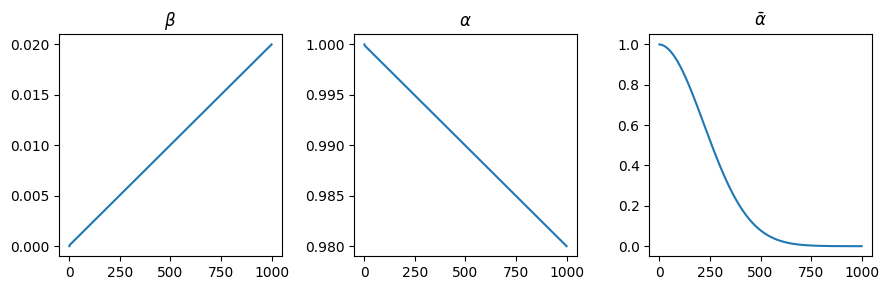

In [ ]:
class LinearSchedule:
    """A linear nosie schedule"""

    def __init__(self, num_diffusion_steps, beta_start, beta_end):
        self.num_diffusion_steps = num_diffusion_steps
        self.beta = jnp.linspace(beta_start, beta_end, num_diffusion_steps)
        self.beta = jnp.concatenate((jnp.zeros((1)), self.beta))
        self.alpha = 1 - self.beta
        self.alpha_bar = jnp.cumprod(self.alpha)

    def __len__(self):
        return self.num_diffusion_steps

noise_schedule = LinearSchedule(1000, 1e-4, 0.02)
fig, axs = plt.subplots(1, 3, figsize=(9, 3))
axs[0].plot(noise_schedule.beta)
axs[0].set_title(r"$\beta$")
axs[1].plot(noise_schedule.alpha)
axs[1].set_title(r"$\alpha$")
axs[2].plot(noise_schedule.alpha_bar)
axs[2].set_title(r"$\bar\alpha$")
plt.tight_layout()
plt.show()

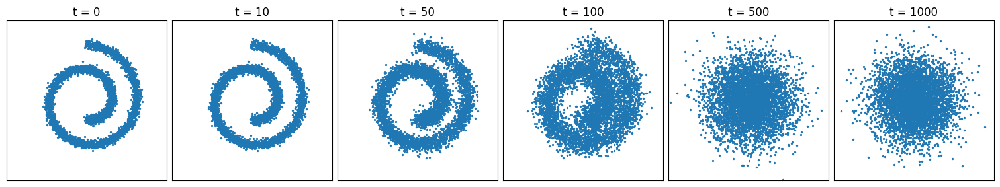

In [ ]:
def plot_forward(dataset, noise_schedule, key):
    x = jnp.stack([jnp.asarray(x) for x, _ in dataset])
    times = (0, 10, 50, 100, 500, 1000)
    fig, axs = plt.subplots(1, len(times), figsize=(3 * (len(times) - 1), 3), constrained_layout=True)
    for i, t in enumerate(times):
        key, subkey = jax.random.split(key)
        eps = jax.random.normal(subkey, x.shape)
        noisy_x = jnp.sqrt(noise_schedule.alpha_bar[t]) * x + jnp.sqrt(1 - noise_schedule.alpha_bar[t]) * eps
        axs[i].scatter(noisy_x[:, 0], noisy_x[:, 1], s=2)
        axs[i].set(xticks=[], yticks=[], xlim=[-4, 4], ylim=[-4, 4], title=f"t = {t}", aspect="equal")
    plt.show()

dataset = get_dataset("swiss roll")
plot_forward(dataset, noise_schedule, key)

## Diffusion Process

In [ ]:
@eqx.filter_jit
def loss_fn(model, x, noise_schedule, key, noise_pred=False):
    """Calculate the loss (Algorithm 1 in Ho et al. 2020)"""
    # TODO: Implement the loss function
    raise NotImplementedError()

def sample(model, shape, noise_schedule, key):
    """Sample through iterative denoising (Algorithm 2 in Ho et al. 2020)"""
    # TODO: Implement the sampling function
    raise NotImplementedError()

## Denoising Model

In [ ]:
class PositionalEmbedding(eqx.Module):
    """
    Positional embeddings for representing low dimensional signals at a given dimension.
    This has proven to be useful when processing low dimensional signals, see https://bmild.github.io/fourfeat/.
    """
    dim: int
    max_positions: int

    def __init__(self, dim, max_positions=10_000):
        assert dim % 2 == 0
        self.dim = dim
        self.max_positions = max_positions

    def __call__(self, x):
        freqs = jnp.arange(0, self.dim // 2) / (self.dim // 2)
        freqs = (1 / self.max_positions) ** freqs
        x = jnp.outer(x, freqs)
        x = jnp.concatenate((jnp.cos(x), jnp.sin(x)), axis=1)[0]
        return x


class Model(eqx.Module):
    """A time-conditoinal denoising model"""
    emb: PositionalEmbedding
    layers: list
    proj1: eqx.nn.Linear
    proj2: eqx.nn.Linear

    def __init__(self, size, dim, key):
        self.emb = PositionalEmbedding(dim)
        keys = jax.random.split(key, 4)
        self.proj1 = eqx.nn.Linear(3 * dim, dim, key=keys[-1])
        self.layers = [eqx.nn.Linear(dim, dim, key=keys[i]) for i in range(3)]
        self.proj2 = eqx.nn.Linear(dim, 2, key=keys[-1])

    def __call__(self, x, t):
        t = self.emb(t)
        x0 = self.emb(25 * x[0])  # Scale up x to match t
        x1 = self.emb(25 * x[1])
        x = jnp.concatenate((x0, x1, t))
        x = jax.nn.silu(self.proj1(x))
        for layer in self.layers:
            x = x + jax.nn.silu(layer(x))
        x = self.proj2(x)
        return x

## Hyperparameters

In [ ]:
# Dataset
dataset = "swiss roll"  # Options: "swiss roll", "kth", "moons", "s-curve"
num_samples = 5000

# Variance schedule
num_diffusion_steps = 1000  # Don't change this, as the value 1000 is assumed throughout
beta_start = 1e-4
beta_end = 0.02

# Denoising model
dim = 256

# Training
steps = 5000
batch_size = 512
learning_rate = 3e-4
weight_decay = 1e-5

## Training

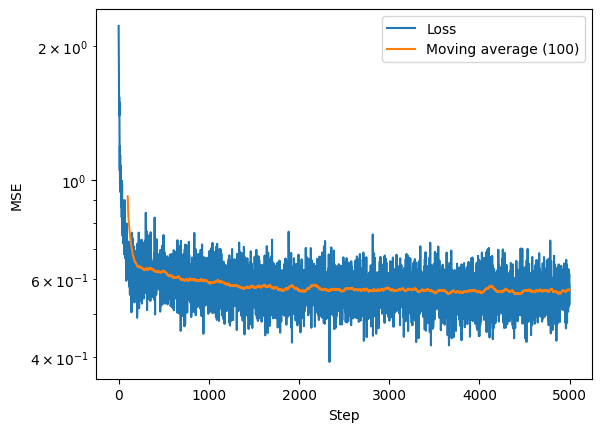

Training: 100%|██████████| 5000/5000 [00:58<00:00, 85.88it/s, loss=0.568]


In [ ]:
dataset = get_dataset(dataset, num_samples)
train_loader = DataLoader(dataset, batch_size, shuffle=True)

noise_schedule = LinearSchedule(num_diffusion_steps, beta_start, beta_end)
model = Model(2, dim, key)
optim = optax.adamw(learning_rate, weight_decay=weight_decay)

opt_state = optim.init(eqx.filter(model, eqx.is_array))
losses = []
pbar = tqdm(range(1, steps + 1), desc="Training")
try:
    for step in pbar:
        x, _ = next(iter(train_loader))
        x = jnp.asarray(x)

        key, subkey = jax.random.split(key)
        loss, grad = eqx.filter_value_and_grad(loss_fn)(model, x, noise_schedule, subkey)
        updates, opt_state = optim.update(grad, opt_state, model)
        model = eqx.apply_updates(model, updates)

        losses.append(loss)
        if step % 100 == 0:
            clear_output(wait=True)
            plt.plot(losses, label="Loss")
            moving_average = np.convolve(losses, np.ones(100), "valid") / 100
            plt.plot(np.arange(step - 100 + 1) + 100, moving_average, label="Moving average (100)")
            plt.yscale("log")
            plt.legend(loc="upper right")
            plt.ylabel("MSE")
            plt.xlabel("Step")
            plt.show()
        pbar.set_postfix(loss=np.mean(losses[-100:]))
except KeyboardInterrupt:  # Allow for manual early stopping
    print("\nTraining interrupted")

## Sampling

In [ ]:
samples = sample(model, (num_samples, 2), noise_schedule, key)

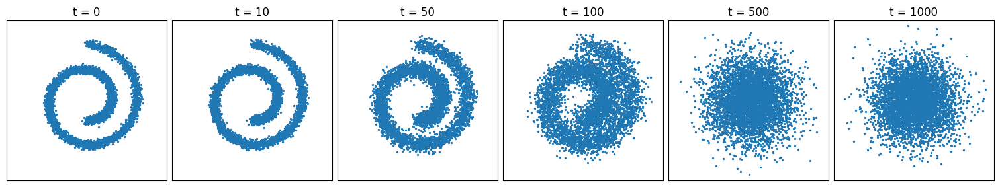

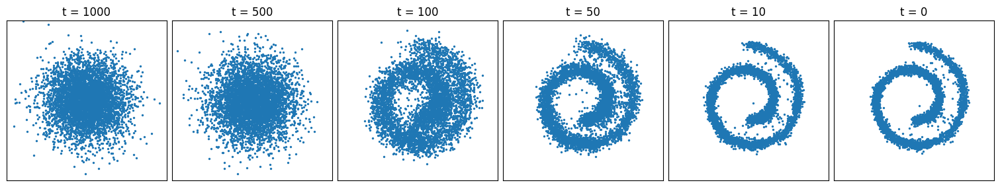

In [ ]:
def plot_backward(samples):
    times = list(reversed((0, 10, 50, 100, 500, 1000)))
    fig, axs = plt.subplots(1, len(times), figsize=(3 * (len(times) - 1), 3), constrained_layout=True)
    for i, t in enumerate(times):
        x = samples[num_diffusion_steps - t]
        axs[i].scatter(x[:, 0], x[:, 1], s=2)
        axs[i].set(xticks=[], yticks=[], xlim=[-4, 4], ylim=[-4, 4], title=f"t = {t}", aspect="equal")
    plt.show()

plot_forward(dataset, noise_schedule, key)
plot_backward(samples)

## Animate

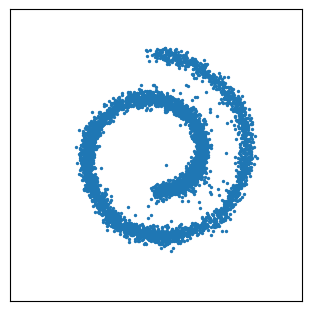

In [ ]:
def animate(samples, filename):
    pbar = tqdm(range(0, 1000), desc="Animating")
    writer = FFMpegWriter(fps=30)
    fig, ax = plt.subplots(figsize=(3, 3), constrained_layout=True)
    plot = ax.scatter(samples[1000, :, 0], samples[1000, :, 1], s=2)
    ax.set(xticks=[], yticks=[], xlim=[-4, 4], ylim=[-4, 4], aspect="equal")
    pbar.update(1)
    with writer.saving(fig, filename, 200):
        for i in pbar:
            plot.set_offsets(samples[i])
            writer.grab_frame()

filename = "reverse_diffusion.mp4"
animate(samples, filename)
clear_output(wait=True)

In [ ]:
moviepy.editor.ipython_display(filename)

**An optional challenge!** Try tuning the model to generate a KTH logo like below


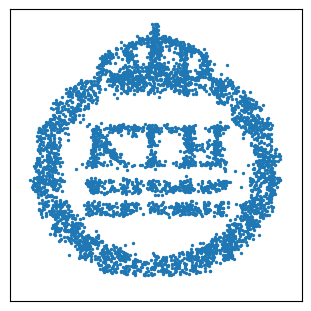

Finally, it is valuable to know, how long did it take you to finish this practical?